# APD DETECTION
ANUGRAH AIDIN YOTOLEMBAH

#**🚨 sebelum membuat kode program, di mohon untuk mengubah runtime ke mode gpu

## STEP 1 : menginstal Library Package python

In [1]:
%%capture
!pip install super-gradients==3.1.0
!pip install imutils
!pip install roboflow
!pip install pytube --upgrade

In [2]:
!pip install super-gradients

#**🚨 Restart the Run Time**

# Step 02: Import Librarys

In [3]:
from super_gradients.training import Trainer
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val

The console stream is logged into /root/sg_logs/console.log


[2024-02-29 06:57:59] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2024-02-29 06:57:59] WARNING - __init__.py - Failed to import pytorch_quantization
[2024-02-29 06:57:59] INFO - utils.py - NumExpr defaulting to 2 threads.
[2024-02-29 06:58:12] WARNING - calibrator.py - Failed to import pytorch_quantization
[2024-02-29 06:58:12] WARNING - export.py - Failed to import pytorch_quantization
[2024-02-29 06:58:12] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [4]:
from IPython.display import clear_output


In [5]:
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback



In [6]:
from super_gradients.training import models


##  STEP 3 : membuat check point dalam directory untuk data train

In [7]:
CHECKPOINT_DIR = 'checkpoints2'
trainer = Trainer(experiment_name='ppe_yolonas_run2', ckpt_root_dir=CHECKPOINT_DIR)

## STEP 4: memasukkan apikey dataset image roboflow  ke dalam google colab

In [8]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="6jnEorjCrjLrIuI3IGb4")
project = rf.workspace("objet-detect-yolov5").project("eep_detection-u9bbd")
dataset = project.version(1).download("yolov5")



loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to EEP_Detection-1 in yolov5pytorch::   0%|          | 0/6482 [00:00<?, ?it/s]

Extracting Dataset Version Zip to EEP_Detection-1 in yolov5pytorch:: 100%|██████████| 6482/6482 [00:00<00:00, 6761.08it/s]


## STEP 5 : Memasukkan dataset ke dalam Directiory

pada tahapaan ini, akan di buatkan directory baru dengan nama EEP_Detection-1 yang berisi directiory train, test, valid, dll

In [9]:
dataset_params = {
    'data_dir':'/content/EEP_Detection-1',
    'train_images_dir':'train/images',
    'train_labels_dir':'train/labels',
    'val_images_dir':'valid/images',
    'val_labels_dir':'valid/labels',
    'test_images_dir':'test/images',
    'test_labels_dir':'test/labels',
    'classes': ['Protective Helmet', 'Shield', 'Jacket', 'Dust Mask', 'Eye Wear', 'Glove', 'Protective Boots']
}


## STEP 6 : menginisialisasikan class, labels directory, images directory dalam train data, validation data, testing data dalam dataset

In [10]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

clear_output()

Indexing dataset annotations: 100%|██████████| 324/324 [00:00<00:00, 3548.97it/s]


## STEP 7 : melakukan transfoms pada dataset

In [11]:
train_data.dataset.transforms

In [12]:
train_data.dataset.dataset_params['transforms'][1]

{'DetectionRandomAffine': {'degrees': 10.0, 'translate': 0.1, 'scales': [0.1, 2], 'shear': 2.0, 'target_size': [640, 640], 'filter_box_candidates': True, 'wh_thr': 2, 'area_thr': 0.1, 'ar_thr': 20}}

In [13]:
train_data.dataset.dataset_params['transforms'][1]['DetectionRandomAffine']['degrees'] = 10.42

## STEP 8 :  melihat visualisasi setiap plot dari dataset gambar yang telah dilakukan transfrom

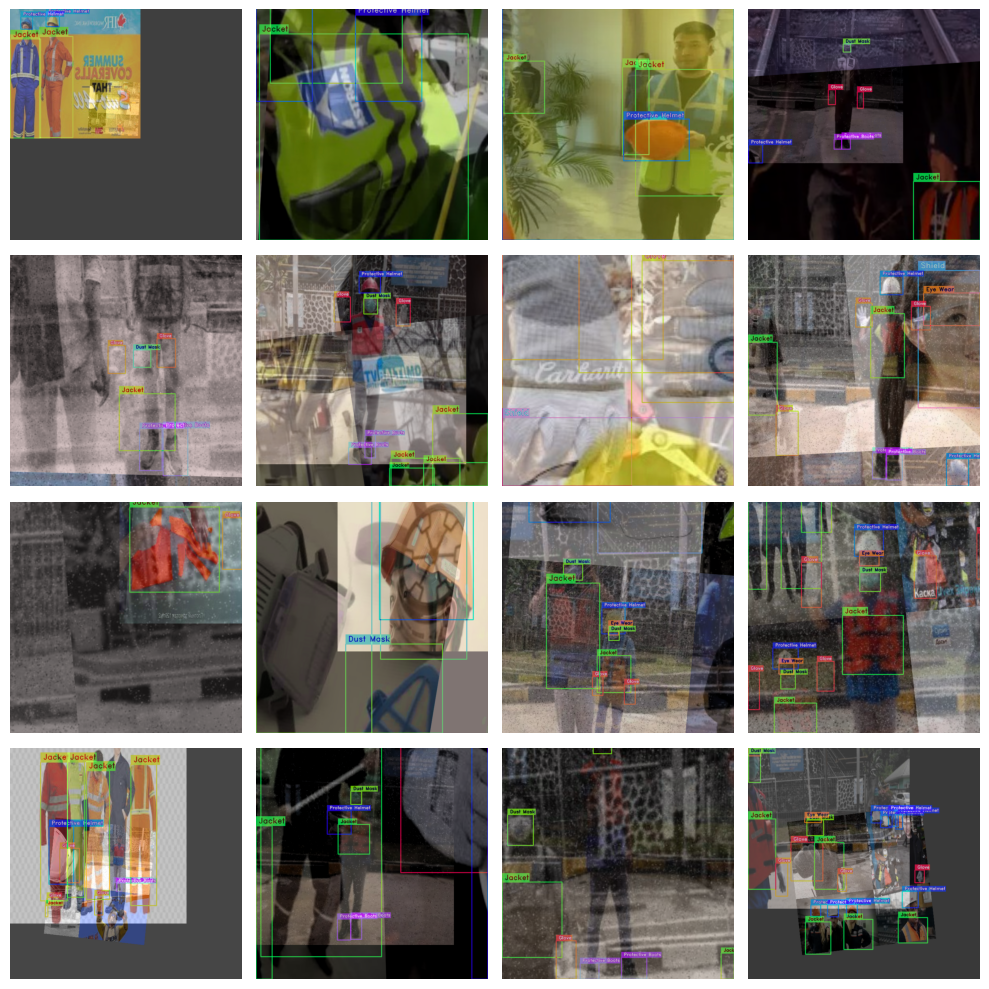

In [14]:
train_data.dataset.plot()

## STEP 9 : Insialisasi model

pada tahap ini saya memakai model dari yolo dan super gradiens dan untuk weight pada dataset ini menggunakan coco bawaan dari yolo

In [15]:
model = models.get('yolo_nas_s',
                   num_classes=len(dataset_params['classes']),
                   pretrained_weights="coco"
                   )

[2024-02-29 06:59:36] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:01<00:00, 40.0MB/s]
[2024-02-29 06:59:38] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_s


## STEP 10 : Inisialisasi parameter training

memasukkan parameter training seperti :

- max_epochs = jumlah epoch untuk dilakukan training data

- loss = memakai loss function untuk mengetahui nilai yang telah digunakan

- optimizer = agar model tetap optimal dalam proses training data

- train_metrics_list  = melihat grafik metriks dari proses training

- valid_metrics_list = melihat grafik metriks dari proses validation



In [16]:
train_params = {
    # ENABLING SILENT MODE
    'silent_mode': True,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 10,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

## STEP 11 : Mendownload demo videos

In [17]:
!gdown "https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid"

/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(


In [18]:
!gdown "https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid"

/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(
Downloading...
From: https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
To: /content/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
1.09MB [00:00, 617MB/s]


In [19]:
!gdown "https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid"

/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(
Downloading...
From: https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
To: /content/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
1.09MB [00:00, 680MB/s]


In [20]:
!gdown "https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid"


/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(


In [21]:
!gdown "https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid"

/usr/local/lib/python3.10/dist-packages/gdown/parse_url.py:44: UserWarning: You specified a Google Drive link that is not the correct link to download a file. You might want to try `--fuzzy` option or the following url: https://drive.google.com/uc?id=None
  warnings.warn(
Downloading...
From: https://drive.google.com/drive/folders/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
To: /content/1kCItlg3nLnSWPyPKk4In4SBXxQgPIbid
1.09MB [00:00, 445MB/s]


## STEP 12 : Training Models

In [22]:
trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)

[2024-02-29 07:00:04] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20240229_070004_684804`
[2024-02-29 07:00:04] INFO - sg_trainer.py - Checkpoints directory: checkpoints2/ppe_yolonas_run2/RUN_20240229_070004_684804
[2024-02-29 07:00:04] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
Object name `linear_epoch_step` is now deprecated. Please replace it with `LinearEpochLRWarmup`.
initialize_param_groups and update_param_groups usages are deprecated since 3.4.0, will be removed in 3.5.0 and have no effect. 
 Assign different learning rates by passing a mapping of layer name prefixes to lr values through initial_lr training hyperparameter (i.e initial_lr={'backbone': 0.01, 'default':0.1})


The console stream is now moved to checkpoints2/ppe_yolonas_run2/RUN_20240229_070004_684804/console_Feb29_07_00_04.txt


[2024-02-29 07:00:09] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            2264       (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         141        (len(train_loader))
    - Gradient updates per epoch:   141        (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_S  (19.02M parameters, 19.02M optimized)
    - Learning Rates and Weight Decays:
      - default: (19.02M parameters). LR: 0.0005 (19.02M parameters) WD: 0.0, (42.15K parameters), WD: 0.0001, (18.98M parameters)

[2024-02-29 07:02:57] INFO - base_sg_logger.py - Checkpoint saved i

# STEP 13 : Mendapatkan best model

In [24]:
best_model = models.get('yolo_nas_s',
                        num_classes=len(dataset_params['classes']),
                        checkpoint_path="/content/checkpoints2/ppe_yolonas_run2/RUN_20240229_070004_684804/ckpt_best.pth")

[2024-02-29 07:30:22] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/checkpoints2/ppe_yolonas_run2/RUN_20240229_070004_684804/ckpt_best.pth EMA checkpoint.


# STEP 14 : Membuat evalations models

In [25]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1,
                                                   top_k_predictions=300,
                                                   num_cls=len(dataset_params['classes']),
                                                   normalize_targets=True,
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01,
                                                                                                          nms_top_k=1000,
                                                                                                          max_predictions=300,
                                                                                                          nms_threshold=0.7)
                                                  ))

Testing:  95%|█████████▌| 20/21 [00:10<00:00,  2.35it/s]

{'PPYoloELoss/loss_cls': 0.7697937,
 'PPYoloELoss/loss_iou': 0.39828745,
 'PPYoloELoss/loss_dfl': 0.43398425,
 'PPYoloELoss/loss': 1.6020654,
 'Precision@0.50': 0.06173103302717209,
 'Recall@0.50': 0.9753233790397644,
 'mAP@0.50': 0.7843347787857056,
 'F1@0.50': 0.11368702352046967,
 'Best_score_threshold': 0.4699999988079071}

Testing: 100%|██████████| 21/21 [00:10<00:00,  1.94it/s]


# STEP 15 : membuat Predict dengan menggunakan Best Models

[2024-02-29 07:30:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


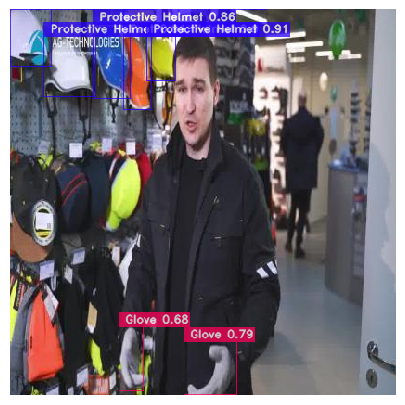

In [26]:
img_url = '/content/EEP_Detection-1/valid/images/Sikctin0132_jpg.rf.9e9d6b610c5dbebd34e34c729065ec8d.jpg'
best_model.predict(img_url).show()

# STEP 16 : Test menggunakan video 1

In [56]:
input_video_path = f"/content/JapanPPE.mp4"
output_video_path = "detections.mp4"

In [57]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [58]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  99%|█████████▉| 4737/4784 [01:19<00:00, 65.94it/s]

# STEP 17 : MENAMPILKAN OUTPUT DALAM BENTUK VIDEO

In [ ]:
# !rm '/content/result_compressed.mp4'

In [59]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections.mp4'

# Compressed video path
compressed_path = "/content/result_compressed2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# Step 18: Testing dalam video ke2

In [42]:
input_video_path = f"/content/hardhat.mp4"
output_video_path = "detections2.mp4"

In [43]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [44]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  97%|█████████▋| 1772/1826 [00:29<00:00, 59.86it/s]

# menampilkan video ke 2

In [39]:
# !rm '/content/result_compressed.mp4'

In [45]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# Result : 
1. saya menggunakan library python package yaitu : 
   - super gradients
   - roboflow
   - pytorch
   - imutils

2. Runtime yang saya gunakan yaitu GPU

3. di sini saya menggunakan image dataset dari api key roboflow dengan kata kunci PPE (Personal Protective Equipmnet) di karnakan dataset ini cocok di terapkan untuk mendeteksi APD (Alat Perlindungan Diri).

4. saya membuat 7 class yang akan melakukan deteksi dan sesuai yang di minta  yaitu :
   - Protective Helmet
   - Shield
   - Jacket Pekerja
   - Dust Mask
   - Eye Wear
   - Glove
   - Protective Boots

5. saya menggunakan models yolov5/ yoloNas dengan bobot/ weight yaitu coco bawaan dari yolo.

6. pada saat training image saya menggunakan 10 epoch dan threshold sebanyak 0.7 di karnakan value dari epoch dan threshold untuk detection objeck sudah menghasilkan gambar detection yang baik. 

7. output saat di tampilkan pada mode gambar, kode program berhasil medeteksi object PPE / APD dengan baik dan sesuai class yang telah di tentukan, contohnya ketika muncul gambar sarung tangan/ glove, kode program atau models yolo bisa mendeteksi bahwa itu sarung tangan, begitu pun dengan class yang lain.

8. output saat di tampilkan pada mode video, awalnya saya mencoba contoh video yang di berikan, tetapi hasil untuk mendeteksi object APD kurang akurat di karnakan menurut saya faktor video yang di berikan jauh dari pandangan untuk melakukan detection object. 

untuk itu saya menggunakan video saya sendiri dan ketika kode program / models yang telah di latih menggunakan yolo, object yang didalam video berhasil terdeteksi sesuai class detection yang telah di tentukan, hampir semuanya mendekati  akurat dan sesuai untuk melakukan deteksi object APD, tetapi ada sedikit keliru ketika mendeteksi papan iklan dalam video yang berwarna orange, papan iklan tersebut di deteksi sebagai jacket pekerja bangunan. 